# Lab 6
Alon Hillel-Tuch (ah5647), Md Sarker (mbs9284), Copeland Myrie (cm5761), Marty Trice(mgt9613)

In [ ]:
Group = "15"
Course = "ISSEM"
Lab = "Lab6"
print("Group:"+Group,Lab, "Course:"+Course)

Group:15 Lab6 Course:ISSEM


In [ ]:
!pip install hvac
# The command !pip install hvac installs the hvac library, which stands for HashiCorp Vault API.
# HashiCorp Vault is a tool for securely accessing secrets, such as API keys, passwords, and certificates. We use it as a means of securely storing data.

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 144.9/144.9 kB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.1/61.1 kB 3.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pyhcl: filename=pyhcl-0.4.4-py3-none-any.whl size=50127 sha256=45d454bb60635d41352163c7318b08f7abb29342f00f5c156c804590dea766cc
  Stored in directory: /root/.cache/pip/wheels/6c/ad/33/e11e917cf04cb1533cab6e7aaa8cee93c950aa82c32398b83e
Successfully built pyhcl


### Vault Functions

The code sets up a Vault client, authenticates with a root token, and stores a token in the Vault. It also includes functions for creating a Vault client, running a command to start the Vault server in development mode, and retrieving the stored token from the Vault.

In [ ]:
import hvac
import sys
import time

import subprocess
import threading

def create_vault_client():
    # Set up the Vault client
    client = hvac.Client(url='http://localhost:8200')

    # Authenticate with the root token provided when starting the Vault server in development mode
    client.token = 'dev-only-token' # This is for testing only and should not be used in production

    return client

def run_command():
    # Start the Vault server in development mode using a root token for testing purposes
    command = "vault server -dev -dev-root-token-id=dev-only-token"
    subprocess.run(command, shell=True)

def get_stored_token(client):
    # Retrieve the stored token from Vault
    try:
        response = client.secrets.kv.v2.read_secret_version(
            path='secret/data/token',raise_on_deleted_version=True
        )
        stored_token = response['data']['data']['value']
        return stored_token
    except Exception as e:
        print("Error retrieving stored token:", e)
        return None

# Start the Vault server in a separate thread
run_vault = threading.Thread(target=run_command)
run_vault.start()
time.sleep(5)

# Set up the Vault client
client = create_vault_client()

# Store the token in the Vault
create_response = client.secrets.kv.v2.create_or_update_secret(
    path='secret/data/token',
    secret=dict(value='!Q#E%T&U8i6y4r2w')
)

# For testing purposes, retrieve and print the stored token
stored_token = get_stored_token(client)
if stored_token:
    print("Stored token:", stored_token)
else:
    print("Failed to retrieve stored token")


ConnectionError: ignored

### Patched SampleNetworkServer.py

In [ ]:
%matplotlib notebook
import threading
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import infinc
import time
import math
import socket
import fcntl
import os
import errno

import string

import secrets
from collections import deque
from threading import Lock
import hvac

#from run_vault import create_vault_client
#from run_vault import get_stored_token

# changes:
# switched UDP to TCP
# random fix
# DOS/DOS rate fix
# hashicorp vault for token
# error handling

# Vulnerability 1 global constants
MAX_REQUESTS_PER_SECOND = 100
MAX_IPS = 10

class SmartNetworkThermometer(threading.Thread):
    open_cmds = ["AUTH", "LOGOUT"]
    prot_cmds = ["SET_DEGF", "SET_DEGC", "SET_DEGK", "GET_TEMP", "UPDATE_TEMP"]

    def __init__(self, source, updatePeriod, port):
        threading.Thread.__init__(self, daemon=True)
        #set daemon to be true, so it doesn't block program from exiting
        self.source = source
        self.updatePeriod = updatePeriod
        self.curTemperature = 0
        self.updateTemperature()
        self.tokens = []

        self.serverSocket = socket.socket(socket.AF_INET, socket.SOCK_STREAM)  # switched to TCP in preparation for TLS
        self.serverSocket.bind(("127.0.0.1", port))
        self.serverSocket.listen(5)  # Listen for incoming connections

        self.deg = "K"

        # Vulnerability 1 Rate limiter attributes (for DDOS and DOS attacks)
        self.max_requests_per_second = MAX_REQUESTS_PER_SECOND
        self.max_ips = MAX_IPS
        self.ip_request_times = {}
        self.ip_locks = {}

        # Set up the Vault client
        self.vault_client = create_vault_client()

    # Vulnerability 1 rate limiting function
    def is_rate_limited(self, ip):
        if ip not in self.ip_request_times:
            self.ip_request_times[ip] = deque(maxlen=self.max_requests_per_second)
            self.ip_locks[ip] = Lock()

        with self.ip_locks[ip]:
            request_times = self.ip_request_times[ip]
            current_time = time.time()
            while request_times and current_time - request_times[0] > 1:
                request_times.popleft()

            if len(request_times) >= self.max_requests_per_second:
                return True

            request_times.append(current_time)
            return False

    def setSource(self, source):
        self.source = source

    def setUpdatePeriod(self, updatePeriod):
        self.updatePeriod = updatePeriod

    def setDegreeUnit(self, s):
        self.deg = s
        if self.deg not in ["F", "K", "C"]:
            self.deg = "K"

    def updateTemperature(self):
        self.curTemperature = self.source.getTemperature()

    def getTemperature(self):
        if self.deg == "C":
            return self.curTemperature - 273
        if self.deg == "F":
            return (self.curTemperature - 273) * 9 / 5 + 32

        return self.curTemperature

    def processCommands(self, msg, clientSocket):
        cmds = msg.split(';')
        for c in cmds:
            cs = c.split(' ')
            if len(cs) == 2:  # should be either AUTH or LOGOUT
                if cs[0] == "AUTH":
                    try:  # Vulnerability 3 error handling: Handle errors during AUTH processing
                        if cs[1] == get_stored_token(self.vault_client):
                            self.tokens.append(''.join(secrets.choice(string.ascii_uppercase + string.ascii_lowercase + string.digits) for _ in range(16)))
                            clientSocket.send(self.tokens[-1].encode("utf-8"))
                        else:
                            clientSocket.send(b"Bad Token\n")
                    except:
                        clientSocket.send(b"Error processing AUTH\n")
                elif cs[0] == "LOGOUT":
                    try:  # Vulnerability 3 error handling: Handle errors during LOGOUT processing
                        if cs[1] in self.tokens:
                            self.tokens.remove(cs[1])
                    except:
                        clientSocket.send(b"Error processing LOGOUT\n")
                else:
                    clientSocket.send(b"Invalid Command\n")
            elif c == "SET_DEGF":
                self.deg = "F"
            elif c == "SET_DEGC":
                self.deg = "C"
            elif c == "SET_DEGK":
                self.deg = "K"
            elif c == "GET_TEMP":
                try:  # Vulnerability 3 error handling: Handle errors during GET_TEMP processing
                    clientSocket.send(b"%f\n" % self.getTemperature())
                except:
                    clientSocket.send(b"Error processing GET_TEMP\n")
            elif c == "UPDATE_TEMP":
                try:  # Vulnerability 3 error handling: Handle errors during UPDATE_TEMP processing
                    self.updateTemperature()
                except:
                    clientSocket.send(b"Error processing UPDATE_TEMP\n")
            elif c:
                clientSocket.send(b"Invalid Command\n")

    def run(self):  # the running function
        while True:
            try:
                clientSocket, addr = self.serverSocket.accept()
                ip, _ = addr

                if len(self.ip_request_times) > self.max_ips:
                    clientSocket.send(b"Too many IPs\n")
                    clientSocket.close()
                    continue
                # Vulnerability 1 check if rate limited
                if self.is_rate_limited(ip):
                    clientSocket.send(b"Rate limited\n")
                    clientSocket.close()
                    continue

                msg = clientSocket.recv(1024).decode("utf-8").strip()
                cmds = msg.split(' ')
                if len(cmds) == 1:  # protected commands case
                    semi = msg.find(';')
                    if semi != -1:  # if we found the semicolon
                        # print (msg)
                        if msg[:semi] in self.tokens:  # if its a valid token
                            self.processCommands(msg[semi + 1:], clientSocket)
                        else:
                            clientSocket.send(b"Bad Token\n")
                    else:
                        clientSocket.send(b"Bad Command\n")
                elif len(cmds) == 2:
                    if cmds[0] in self.open_cmds:  # if its AUTH or LOGOUT
                        self.processCommands(msg, clientSocket)
                    else:
                        clientSocket.send(b"Authenticate First\n")
                else:
                    # otherwise bad command
                    clientSocket.send(b"Bad Command\n")

                clientSocket.close()

            except IOError as e:
                if e.errno == errno.EWOULDBLOCK:
                    pass
                else:
                    clientSocket.send(b"Error\n")

            self.updateTemperature()
            time.sleep(self.updatePeriod)




class SimpleClient:
    def __init__(self, therm1, therm2):
        self.fig, self.ax = plt.subplots()
        now = time.time()
        self.lastTime = now
        self.times = [time.strftime("%H:%M:%S", time.localtime(now - i)) for i in range(30, 0, -1)]
        self.infTemps = [0] * 30
        self.incTemps = [0] * 30
        self.infLn, = plt.plot(range(30), self.infTemps, label="Infant Temperature")
        self.incLn, = plt.plot(range(30), self.incTemps, label="Incubator Temperature")
        plt.xticks(range(30), self.times, rotation=45)
        plt.ylim((20, 50))
        plt.legend(handles=[self.infLn, self.incLn])
        self.infTherm = therm1
        self.incTherm = therm2

        self.ani = animation.FuncAnimation(self.fig, self.updateInfTemp, interval=500)
        self.ani2 = animation.FuncAnimation(self.fig, self.updateIncTemp, interval=500)

    def updateTime(self):
        now = time.time()
        if math.floor(now) > math.floor(self.lastTime):
            t = time.strftime("%H:%M:%S", time.localtime(now))
            self.times.append(t)
            # last 30 seconds of data
            self.times = self.times[-30:]
            self.lastTime = now
            plt.xticks(range(30), self.times, rotation=45)
            plt.title(time.strftime("%A, %Y-%m-%d", time.localtime(now)))

    def updateInfTemp(self, frame):
        self.updateTime()
        inf_temp = self.infTherm.getTemperature() - 273

        try:  # Vulnerability 3 error handling: Handle errors during updating infant temperature
            with socket.socket(socket.AF_INET, socket.SOCK_STREAM) as clientSocket:
                clientSocket.connect(("127.0.0.1", 23456))
                clientSocket.sendall(str(inf_temp).encode("utf-8"))
        except Exception as e:
            print("Error sending infant temperature:", e)

        self.infTemps.append(inf_temp)
        self.infTemps = self.infTemps[-30:]
        self.infLn.set_data(range(30), self.infTemps)
        return self.infLn,

    def updateIncTemp(self, frame):
        self.updateTime()
        inc_temp = self.incTherm.getTemperature() - 273

        try:  # Vulnerability 3 error handling: Handle errors during updating incubator temperature
            with socket.socket(socket.AF_INET, socket.SOCK_STREAM) as clientSocket:
                clientSocket.connect(("127.0.0.1", 23457))
                clientSocket.sendall(str(inc_temp).encode("utf-8"))
        except Exception as e:
            print("Error sending incubator temperature:", e)

        self.incTemps.append(inc_temp)
        self.incTemps = self.incTemps[-30:]
        self.incLn.set_data(range(30), self.incTemps)
        return self.incLn,

UPDATE_PERIOD = .05 #in seconds
SIMULATION_STEP = .1 #in seconds

#create a new instance of IncubatorSimulator
bob = infinc.Human(mass = 8, length = 1.68, temperature = 36 + 273)
#bobThermo = infinc.SmartThermometer(bob, UPDATE_PERIOD)
bobThermo = SmartNetworkThermometer(bob, UPDATE_PERIOD, 23456)
bobThermo.start() #start the thread

inc = infinc.Incubator(width = 1, depth=1, height = 1, temperature = 37 + 273, roomTemperature = 20 + 273)
#incThermo = infinc.SmartNetworkThermometer(inc, UPDATE_PERIOD)
incThermo = SmartNetworkThermometer(inc, UPDATE_PERIOD, 23457)
incThermo.start() #start the thread

incHeater = infinc.SmartHeater(powerOutput = 1500, setTemperature = 45 + 273, thermometer = incThermo, updatePeriod = UPDATE_PERIOD)
inc.setHeater(incHeater)
incHeater.start() #start the thread

sim = infinc.Simulator(infant = bob, incubator = inc, roomTemp = 20 + 273, timeStep = SIMULATION_STEP, sleepTime = SIMULATION_STEP / 10)

sim.start()

sc = SimpleClient(bobThermo, incThermo)

plt.grid()
plt.show()


ModuleNotFoundError: ignored

### Patched SampleNetworkClient.py

<IPython.core.display.Javascript object>


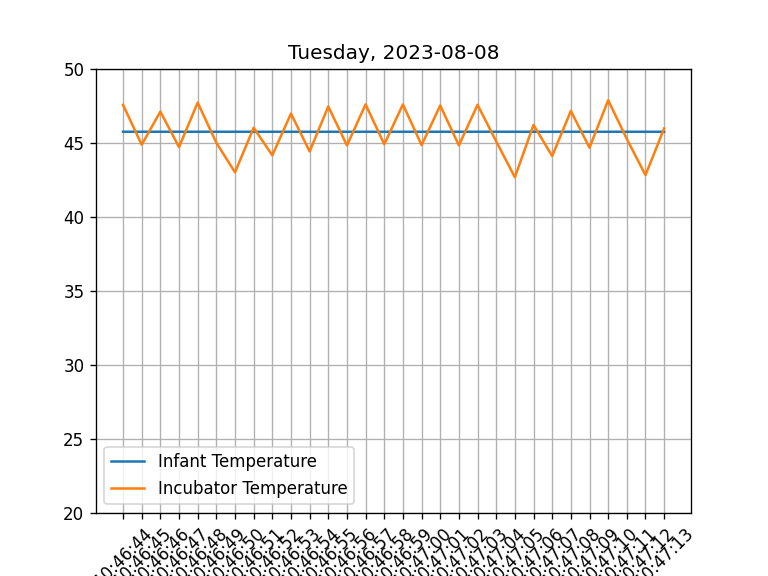

/tmp/ipykernel_3943/137157569.py:66: UserWarning: frames=None which we can infer the length of, did not pass an explicit *save_count* and passed cache_frame_data=True.  To avoid a possibly unbounded cache, frame data caching has been disabled. To suppress this warning either pass `cache_frame_data=False` or `save_count=MAX_FRAMES`.
  self.ani = animation.FuncAnimation(self.fig, self.updateInfTemp, interval=500)
/tmp/ipykernel_3943/137157569.py:67: UserWarning: frames=None which we can infer the length of, did not pass an explicit *save_count* and passed cache_frame_data=True.  To avoid a possibly unbounded cache, frame data caching has been disabled. To suppress this warning either pass `cache_frame_data=False` or `save_count=MAX_FRAMES`.
  self.ani2 = animation.FuncAnimation(self.fig, self.updateIncTemp, interval=500)


In [ ]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import time
import math
import socket

import hvac
import sys
from functools import wraps

#from run_vault import get_stored_token
#from run_vault import create_vault_client

import ssl

# Vulnerability 1 rate limiting global constant
RATE_LIMIT = 100  # per second
TOKEN_EXPIRATION = 7200 # Vulnerability 4 - input validation: 7200/60 = 120 minutes

# Vulnerability 1 we provide a wrapper around functions that contact the server to limit them to maximum RATE_MINUTE calls per second
def rate_limited(max_per_second):
    min_interval = 1.0 / float(max_per_second)

    def decorate(func):
        last_time_called = [0.0]

        @wraps(func)
        def rate_limited_function(*args, **kwargs):
            elapsed = time.perf_counter() - last_time_called[0]
            left_to_wait = min_interval - elapsed
            if left_to_wait > 0:
                time.sleep(left_to_wait)
            ret = func(*args, **kwargs)
            last_time_called[0] = time.perf_counter()
            return ret

        return rate_limited_function

    return decorate


class SimpleNetworkClient:
    def __init__(self, port1, port2):
        self.fig, self.ax = plt.subplots()
        now = time.time()
        self.lastTime = now
        self.times = [time.strftime("%H:%M:%S", time.localtime(now - i)) for i in range(30, 0, -1)]
        self.infTemps = [0] * 30
        self.incTemps = [0] * 30
        self.infLn, = plt.plot(range(30), self.infTemps, label="Infant Temperature")
        self.incLn, = plt.plot(range(30), self.incTemps, label="Incubator Temperature")
        plt.xticks(range(30), self.times, rotation=45)
        plt.ylim((20, 50))
        plt.legend(handles=[self.infLn, self.incLn])
        self.infPort = port1
        self.incPort = port2

        # Vulnerability 5 access controls
        self.infToken = {"token": None, "expiration_time": 0}
        self.incToken = {"token": None, "expiration_time": 0}


        self.ani = animation.FuncAnimation(self.fig, self.updateInfTemp, interval=500)
        self.ani2 = animation.FuncAnimation(self.fig, self.updateIncTemp, interval=500)

        # Set up the Vault client
        self.vault_client = create_vault_client()

    # Vulnerability 5 access controls
    def is_token_valid(self, token):
        return token["expiration_time"] >= time.time()

    def updateTime(self):
        now = time.time()
        if math.floor(now) > math.floor(self.lastTime):
            t = time.strftime("%H:%M:%S", time.localtime(now))
            self.times.append(t)
            # last 30 seconds of data
            self.times = self.times[-30:]
            self.lastTime = now
            plt.xticks(range(30), self.times, rotation=45)
            plt.title(time.strftime("%A, %Y-%m-%d", time.localtime(now)))

    @rate_limited(RATE_LIMIT)
    def getTemperatureFromPort(self, p, tok):
        try:
            with socket.socket(socket.AF_INET, socket.SOCK_STREAM) as s:
                context = ssl.create_default_context(ssl.Purpose.SERVER_AUTH)
                context.check_hostname = False  # Disable hostname verification - ONLY BECAUSE WE DO NOT HAVE A SIGNED CERT TO USE
                context.verify_mode = ssl.CERT_NONE  # Disable certificate verification - ONLY BECAUSE WE DO NOT HAVE A SIGNED CERT TO USE
                ssl_socket = context.wrap_socket(s, server_hostname="127.0.0.1")
                ssl_socket.connect(("127.0.0.1", p))
                ssl_socket.sendall(b"%s;GET_TEMP" % tok.encode("utf-8"))
                msg = ssl_socket.recv(1024)
            m = msg.decode("utf-8")
            if m.startswith("Bad Token"):
                print("Received 'Bad Token' response, removing token and re-authenticating.")
                self.infToken["token"] = None
                return None
            try:
                temperature = float(m)
                return temperature
            except ValueError:
                print("Received non-numeric value:", m)
                return None  # Vulnerability 3 error handling: Return None on error
            except socket.error as e:
                print("Error receiving response from server:", e) #inside loop insight for vulnerability 3
                return None
        except socket.error as e:
            print("Socket error:", e)
            return None  # Vulnerability 3 error handling: Return None on error



    @rate_limited(RATE_LIMIT)
    def authenticate(self, p, pw):
        try:
            with socket.socket(socket.AF_INET, socket.SOCK_STREAM) as s:
                context = ssl.create_default_context(ssl.Purpose.SERVER_AUTH)
                context.check_hostname = False # Disable hostname verification - ONLY BECAUSE WE DO NOT HAVE A SIGNED CERT TO USE
                context.verify_mode = ssl.CERT_NONE # Disable certificate verification - ONLY BECAUSE WE DO NOT HAVE A SIGNED CERT TO USE
                ssl_socket = context.wrap_socket(s, server_hostname="127.0.0.1")
                ssl_socket.connect(("127.0.0.1", p))
                ssl_socket.sendall(b"AUTH %s" % pw)
                msg = ssl_socket.recv(1024).strip()
                token = msg.decode("utf-8")
                if token == "Bad Token":
                    print("Received 'Bad Token' response during authentication.")
                    return None
                # Vulnerability 5 access controls - we allow the TOKEN_EXPIRATION to be modified in this code, but Server ALWAYS CHECKS it is <= it's own set expiration time
                expiration_time = time.time() + TOKEN_EXPIRATION
                return {"token": token, "expiration_time": expiration_time}
        except socket.error as e:
            print("Socket error:", e)
            return None # Vulnerability 3 error handling: Return None on error

    def updateInfTemp(self, frame):
        self.updateTime()  # Vulnerability 5 access controls

        # Check if token is None or expired
        if self.infToken["token"] is None or not self.is_token_valid(self.infToken):
            new_token = self.authenticate(self.infPort, get_stored_token(self.vault_client).encode('utf-8'))
            if new_token is not None:
                self.infToken = new_token
            else:
                return self.infLn,  # Return early if token retrieval fails

        # Vulnerability 5 access controls
        if self.infToken["token"] is not None and self.is_token_valid(self.infToken):
            temperature = self.getTemperatureFromPort(self.infPort, self.infToken["token"])

            if temperature is not None and isinstance(temperature, float):
                self.infTemps.append(temperature - 273)
            else:
                print("Discarded non-float temperature:", temperature)  # Vulnerability 3 error handling for rate limiting

        self.infTemps = self.infTemps[-30:]
        self.infLn.set_data(range(30), self.infTemps)
        return self.infLn,



    def updateIncTemp(self, frame):
        self.updateTime()  # Vulnerability 5 access controls

        # Check if token is None or expired
        if self.incToken["token"] is None or not self.is_token_valid(self.incToken):
            new_token = self.authenticate(self.incPort, get_stored_token(self.vault_client).encode('utf-8'))
            if new_token is not None:
                self.incToken = new_token
            else:
                return self.incLn,  # Return early if token retrieval fails

        # Vulnerability 5 access controls
        if self.incToken["token"] is not None and self.is_token_valid(self.incToken):
            temperature = self.getTemperatureFromPort(self.incPort, self.incToken["token"])

            if temperature is not None and isinstance(temperature, float):
                self.incTemps.append(temperature - 273)
            else:
                print("Discarded non-float temperature:", temperature)  # Vulnerability 3 error handling for rate limiting

        self.incTemps = self.incTemps[-30:]
        self.incLn.set_data(range(30), self.incTemps)
        return self.incLn,


snc = SimpleNetworkClient(23456, 23457)

plt.grid()
plt.show()



### Vulnerability 1 - DoS and DDOS in SimpleNetworkClient.py and SimpleNetworkServer.py

**Test Case Description**: The incubator does not incorporate rate limiting to mitigate the possibility of a DOS or DDOS scenario, ultimately putting it at risk.

**Pre Condition**: Both Client and Server must be running. Based on the current code, there are no checks or boundaries to prevent a malicious character from bombarding the server with a high volume of requests.

**Expected Result**: The Server should identify when there are excessive requests being made and restrict or rate limit at some point.

**Actual Result**: The server will continue to accept the requests, which can ultimately result in a DOS or DDOS.

**Post Condition**: After patching this vulnerability, the server should now ignore/drop any excessive requests and return a response informing the client that their requests are being rate limited.

**Pass/Fail**: Pass

**Explanation**: Without proper rate limiting, the server can receive illegitimate requests from a malicous user, tying up resources and ultimately causing the server to become unresponsive to legitimate requests. By implementing rate limiting, it now restricts the window of requests, which is sufficient for a product such as the incubator.

**Original Code (Unpatched)**

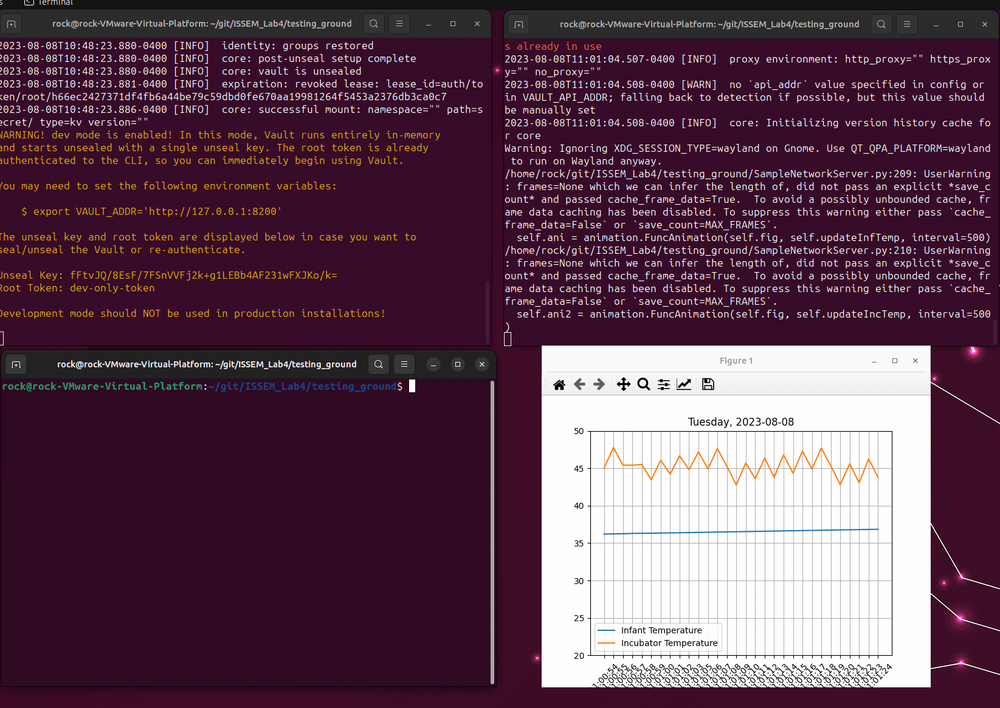

**Post-Patch**

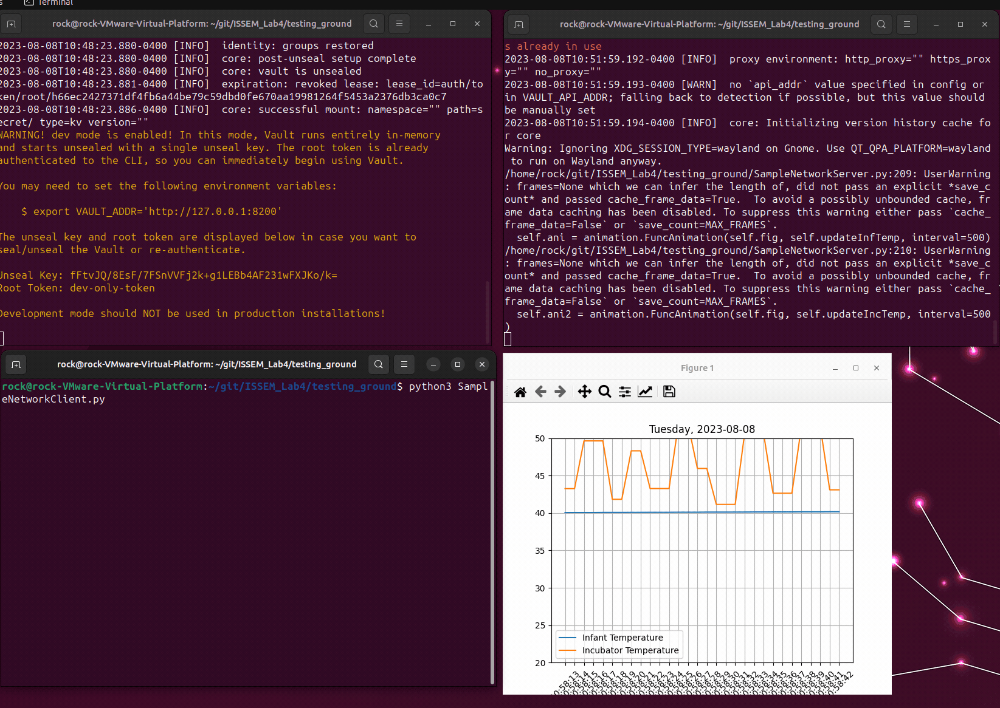

### Vulnerability 2 - Non-Secure Communication and UDP

**<u>Test Case Description</u>:** The incubator uses UDP vs. TCP, resulting in unsecure, and potentially unreliable, communication across the network. The entire codebase is built around plaintext communication over UDP causing authentication and reliability issues.

<u>Issue</u>: The UDP (User Datagram Protocol) is a connectionless and lightweight communication protocol. While it offers low latency and reduced overhead, it lacks essential features like guaranteed delivery, error checking, and even basic security mechanisms. Fuurthermore, there is no enhanced application layer protocol being used to help protect the integrity of the communication, such as SSL/TLS. In the case of an infant incubator, which relies on consistent and accurate communication for settings such as temperature, plaintext UDP poses significant risks:

1) Packet Sniffing Vulnerability: UDP packets are sent in plaintext, making them susceptible to interception by malicious actors. This exposes sensitive data, such as temperature settings and other control commands, to potential eavesdropping.

2) Lack of Reliability: UDP does not provide mechanisms for detecting lost or out-of-order packets. In critical applications like infant incubators, the loss of a packet containing a temperature setting could lead to improper control, jeopardizing the baby's health.

<u>Non-Technical Analogy - Safeguarding Infant Incubator Communication:</u> Imagine we are sending secret messages to a friend using postcards. UDP is like sending these postcards without envelopes, allowing anyone to read the message. This could be disastrous if we are sending important instructions for an infant incubator. Additionally, if a postcard goes missing, our friend might not get the message and we would not know, leading to confusion and potential problems. By switching to TCP and using SSL/TLS, we are sending your messages in sealed envelopes that only your friend can open and we receive a delivery confirmation (on receipt). This ensures privacy and makes sure every message arrives safely, like crucial instructions for the incubator's temperature.


**<u>Pre-Condition</u>:** To validate that the communication is being sent over UDP, both the server and client need to be running simultaneously.

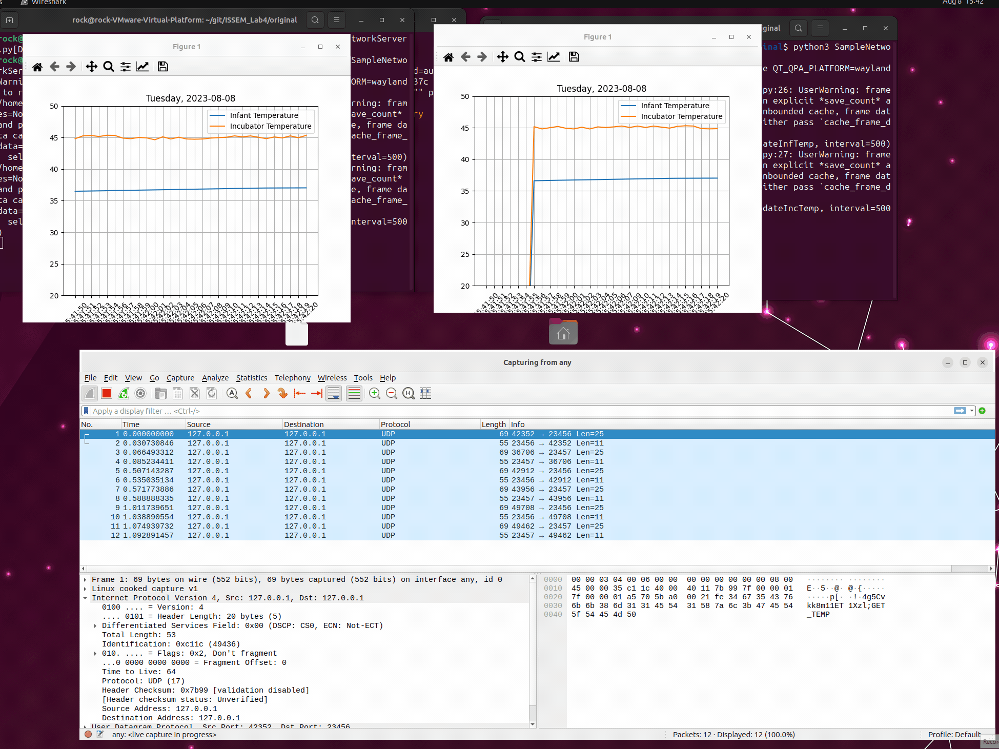

**<u>Expected Result</u>:** Messages sent to and from the client and server should be encrypted, as it can contain sensitive data, such as passwords, and can be susceptible to easedropping or Man in the Middle (MitM) attacks.

**<u>Actual Result</u>:** We can see in the animation that we have full ability to inspect any packet sent (as a 3rd party with network access)

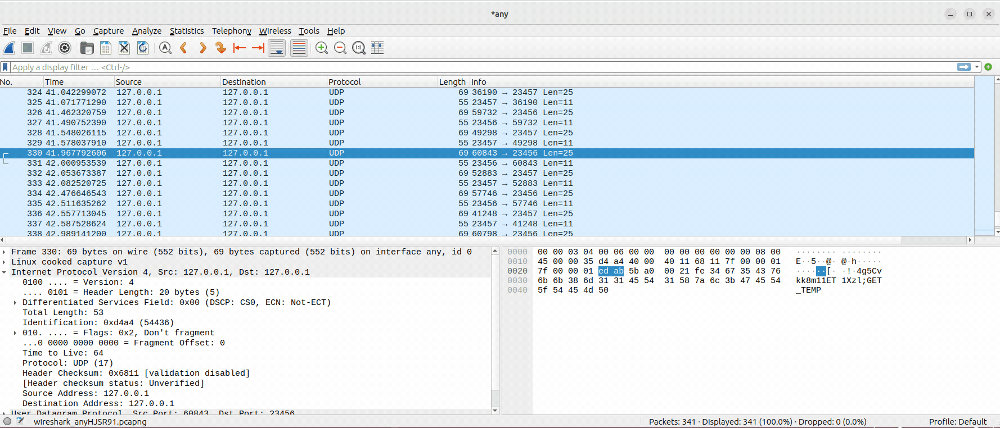

**<u>Post Condition: Self-Signed Certificate Implementation:</u>**

In the process of patching the vulnerabilities, a self-signed certificate was employed as a proof of concept. While a self-signed certificate lacks the validation of a trusted third-party Certificate Authority (CA), it demonstrates the implementation of SSL/TLS encryption. Below we can see the handshake captured.

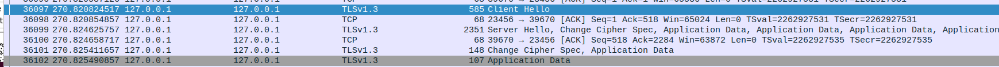

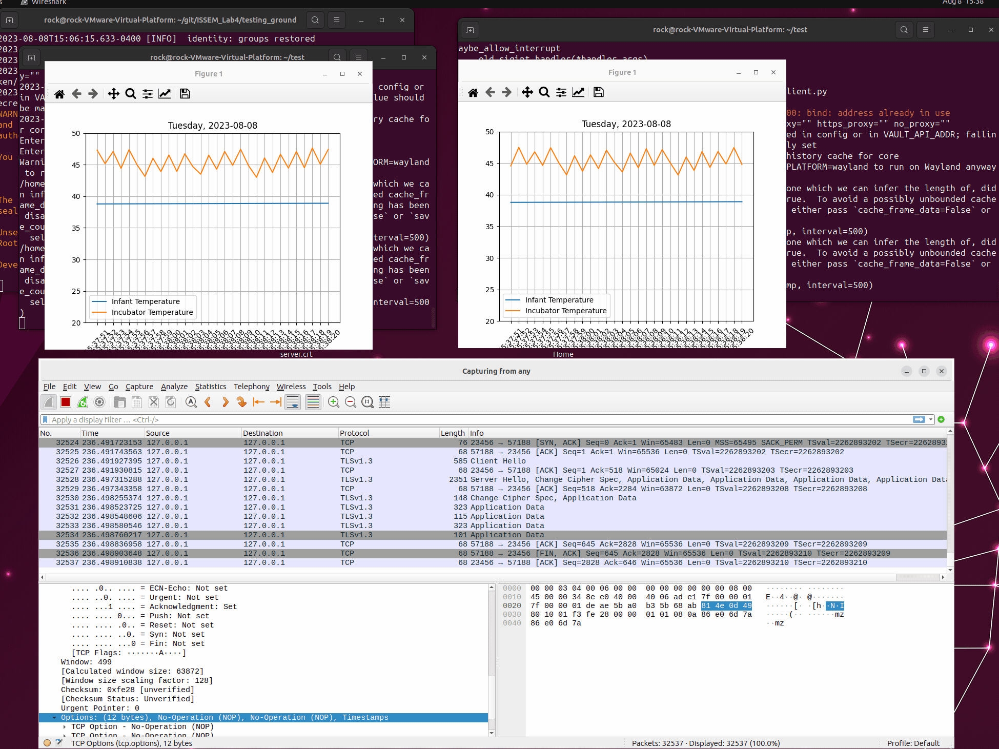

**<u>Pass / Fail</u>:** Pass. We observe the patch in action, providing full TLS communication and encrypted data.

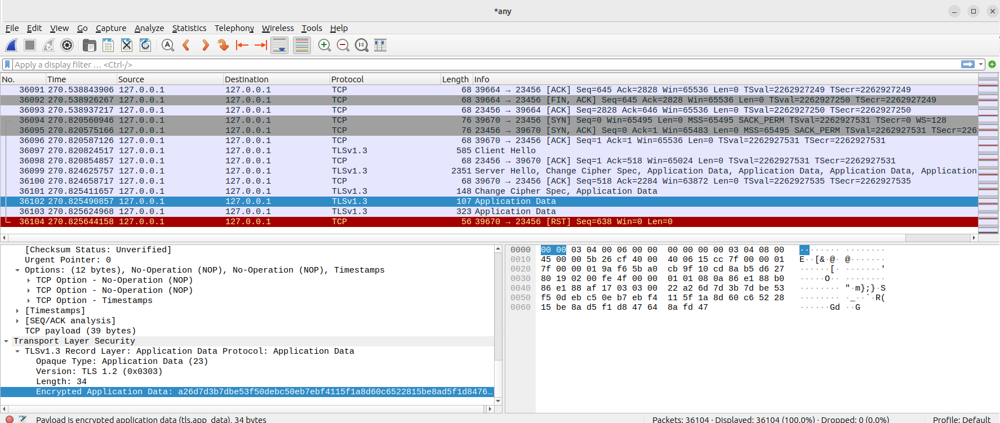

**<u>Explanation:</u>**

The transition from plaintext UDP communication to secure TCP with SSL/TLS encryption represents a significant step toward ensuring the safety and reliability of an infant incubator's control system. By addressing the vulnerabilities associated with plaintext communication and demonstrating the implementation of SSL/TLS through a self-signed certificate, the patch not only safeguards the delicate environment of an infant incubator but also highlights the importance of secure communication in any critical system.

### Vulnerability 3 - Error Handling



**Test Case Description**: The Infant Inclubator lacks error handling.

**Pre Condition**: To validate the issue, the server must be down when running the SampleNetworkClient.py script.

**Expected Result**: The SampleNetworkClient should output details to the user, informing them of an issue and details to help troubleshoot.

**Actual Result**: The SampleNetworkClient hangs and is unresponsive, requiring a "Force Quit".

**Post Condition**: After patching the issue, the SampleNetworkClient script will run without crashing, as well as display a "Connection Refused" message, indicating the SampleNetworkServer is not running on the dedicated port.

**Pass/Fail**: Pass

**Explanation**: The scripts do not provide sufficient context surrounding errors. We can see here a demonstrationof failure toconnect and lack of error handling, completely disconnecting the system, and a patched version that will reconnect after failure.

**Original Code (UnPatched)**

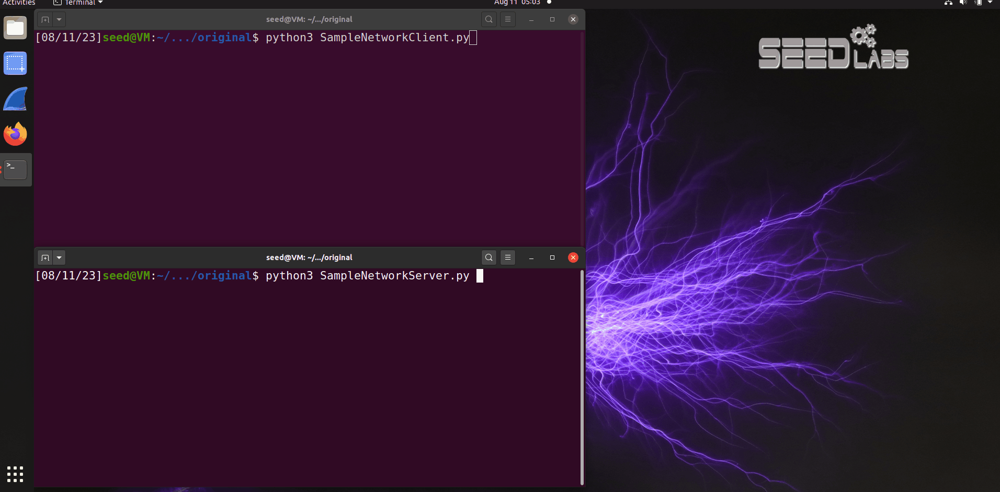

**Post-Patch**



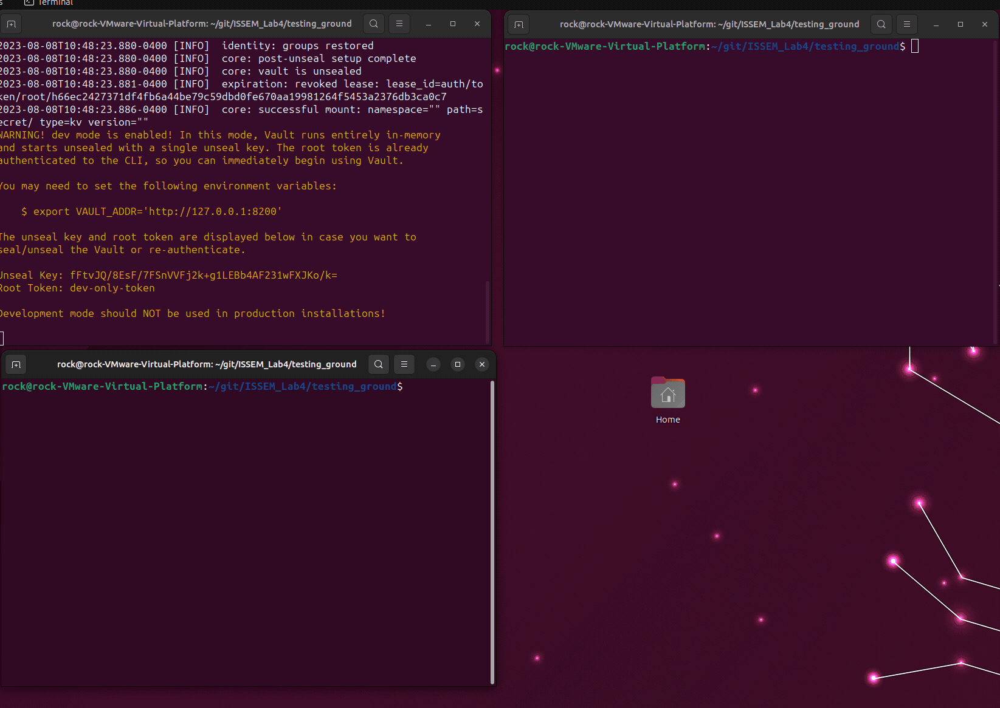

### Vulnerability 4 & 5, respectively - Input Validation and Access Control

**Test Case Description**: The incubator does not restrict commands that are not apart of the prot_cmds; additionally, it does not prevent non-authenticated users from running the prot_cmds.

**Pre Condition**: The client and server must both be running. The code does not include validation to check if the command being sent is one of the prot_cmds and doesnt check to make sure the user is an authenticated user in order to run one of the prot_cmds.

**Expected Result**: The server should return an error if a command that isn't apart of prot_cmds is sent by the client (Bad Command) and if one of the prot_cmds is ran without being authenticated (Authenticate First).

**Actual Result**: The original code does a check to see if the request is for AUTH or LOGOUT and if it's not, it then runs through a series of elifs to see if the request includes one of the prot_cmds (not actually verifying the user sending the request is authenticated).

**Post Condition**: The server, once patched, will authenticate the user, issuing a token (with a set expiration time). If the user tries to pass a command, they the server will check to make sure they are authenticated and then validate the command being requested. If the command is not a prot_cmds, it will return a message of "Bad Command".

**Pass/Fail**: Pass

**Explanation**: Without implementing input validation, the user can pass any command to the server, that could open the incubator up to a remote code execution (RCE) attack. Additionally, without enabling the requirement for the prot_cmds to be ran by authenticated users, this allows unauthenticated users the capability to execute prot_cmds, letting them modify the temperatures required for the incubator to properly operate in a safe condition for the infant.

### Vulnerability 6 - Temperature Management

**Test Case Description**: There are no guardrails to prevent the temperature from exceeding or declining to an unsafe range for the infant.

**Pre Condition**: Server must be running and a defined temperature range needs to be set within the code. In our code, we set the range as followed:

    MIN_INF_TEMPERATURE = 34  # Minimum temperature for infant (93.2°F)
    MAX_INF_TEMPERATURE = 38  # Maximum temperature for infant (100.4°F)
    MIN_INC_TEMPERATURE = 20  # Minimum temperature for incubator (68°F)
    MAX_INC_TEMPERATURE = 47  # Maximum temperature for incubator (116.6°F)

**Expected Result**: If a client requests to adjust the infant or incubator temperature below or above the identified "normal" range, the server should respond with an error and not post the temperature.

**Actual Result**: Based on the current code, there is nothing defined to restrict setting the temperature to an unsafe range.

**Post Condition**: Following a patch of the incubator, a range will need to be defined and if a request to change the temperature is not within the expected range, the incubator should return an error, maintaing the current temperature. **Please note** that for testing purposes, the infant temperature was set to 33.5C to simulate the result of entering an invalid temperature range. During this time, no value will be printed on the chart until a valid temperature range is shared. If a valid range was issued, followed by an invalid range, the temperature will stay at a constant (depicted in the animation below with the incubator).

**Pass/Fail**: Pass

**Explanation**: This is a key feature of the incubator, as malicious characters can manipulate the incubators temperatures to now turn the incubator, which was meant to aid in the survival of the infant, into a possible death trap.

**Original Code (UnPatched)**

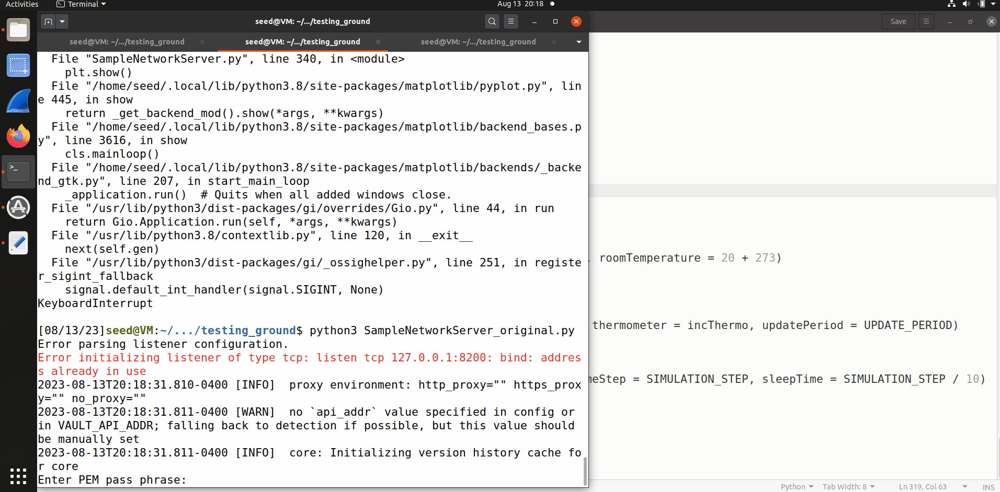

**Post-Patch**

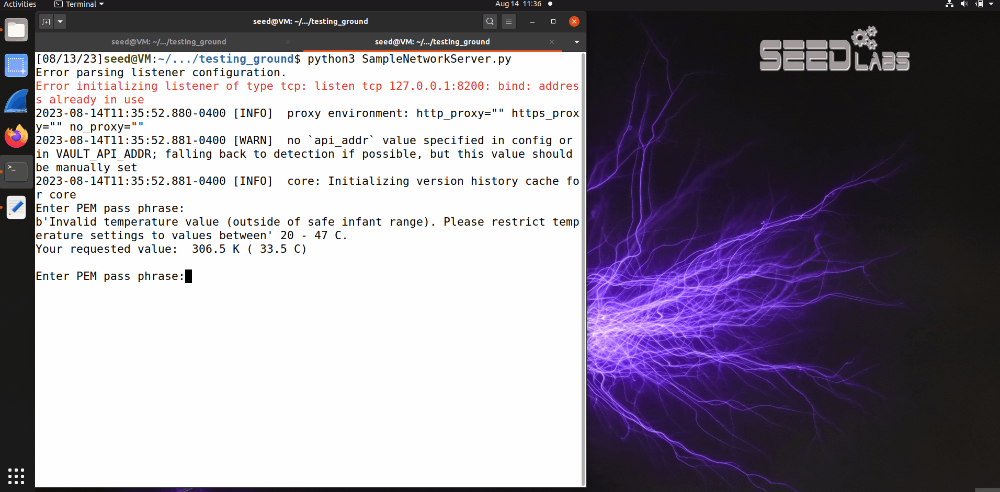

### Unpatched Vulnerabilities

- Vulnerability in the OS library
  * Directory traversal that could allow attackers to potentially gain system access.
  * https://www.bleepingcomputer.com/news/security/unpatched-15-year-old-python-bug-allows-code-execution-in-350k-projects/
  * High Level: Directory traversal is a security vulnerability that allows attackers to read or write files on a server. This can include sensitive information such as application code, data, and credentials. In some cases, attackers can even take full control of the server.
- Init Declarations and Initializations
  * self.infTemps and self.incTemps are not initialized in the init
#  * High Level: The variables do not have a defined value when an object of the class is created. As a result, if these variables are used before being assigned a value, it could lead to unexpected behavior or errors in the program
- socket.recfrom blocks until data is received
  * If no data is received, the program will hang and wait indefinitely. To prevent this, a timeout should be set so that the method will only wait for a specified amount of time before returning. If no data is received within the timeout period, the method will return an error, allowing the incubator program to continue running without being stuck waiting for data.
- Token Storage
  * The processCommands() method stores authentication tokens in a dictionary as an instance variable of the SmartNetworkThermometer class. The dictionary is not protected. An attacker with access to the server’s memory to read the authentication tokens and use them to impersonate legitimate clients.
- Token Usage
  * The method uses a simple token-based authentication system to authenticate clients. While this can provide some level of security, it may not be sufficient for sensitive applications.
- Timing Attack
  * The processCommands() method includes an "AUTH" command that allows clients to authenticate by sending a password. However, the password is compared to the value returned by the authenticate() method using the == operator, which can be vulnerable to timing attacks. A more secure approach would be to use a constant-time comparison function, such as hmac.compare_digest(), to compare the password values.
- System Clock Manipulation
  * Potential solutions include to prevent system clock/time tampering include: (a) Using a Secure Time Source: To mitigate clock manipulation, consider using a reliable and secure time source, such as an NTP (Network Time Protocol) server. NTP can help ensure that your system's clock remains accurate and is less susceptible to manipulation. (b) Alongside the token-based system, we can also include a timestamp in each request. The server can validate that the timestamp is recent and within an acceptable range from the server's perspective. If the timestamp is too far in the past or the future, the request can be rejected. (c) Implement server-side validation of the received timestamp and token. This involves verifying that the timestamp is recent and valid and that the token is associated with the correct timestamp. If either check fails, the server should reject the request. (c) is similar to solution (b), but server side.